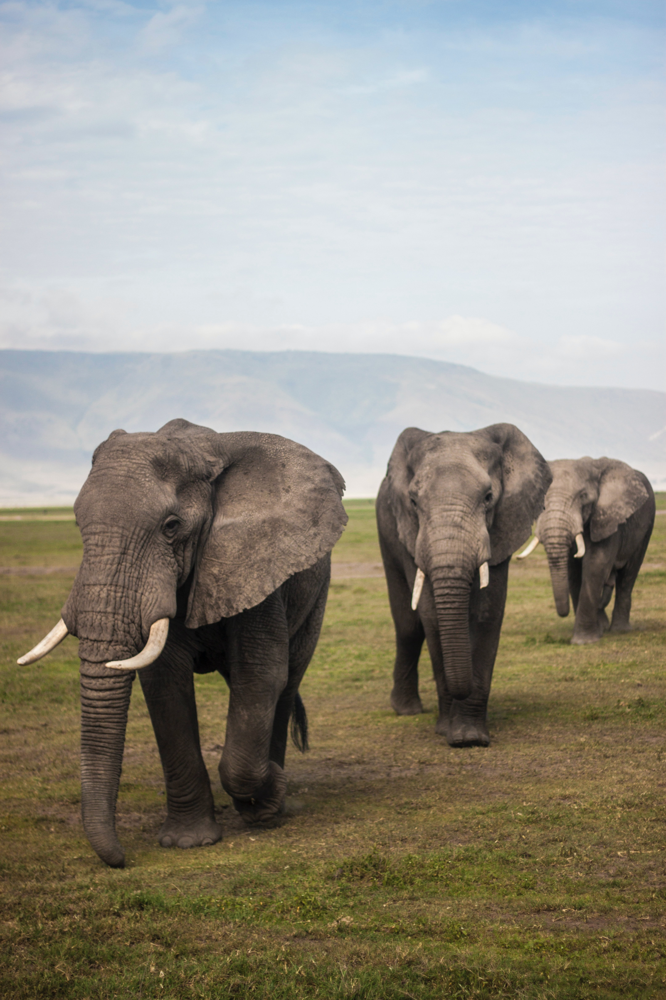

Similarity with elephant :  tensor([0.2584])
Similarity with mammoth :  tensor([0.2386])


In [40]:
import torch
from PIL import Image
from IPython.display import display
from IPython.display import Image as IPyImage
from transformers import CLIPProcessor, CLIPModel

model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

def get_image_feature(filename: str):
    image = Image.open(filename).convert("RGB")
    processed = processor(images=image, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        image_features = model.get_image_features(pixel_values=processed["pixel_values"])
    return image_features

def get_text_feature(text: str):
    processed = processor(text=text, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        text_features = model.get_text_features(processed['input_ids'])
    return text_features

def cosine_similarity(tensor1, tensor2):
    tensor1_normalized = tensor1 / tensor1.norm(dim=-1, keepdim=True)
    tensor2_normalized = tensor2 / tensor2.norm(dim=-1, keepdim=True)
    return (tensor1_normalized * tensor2_normalized).sum(dim=-1)

image_tensor = get_image_feature("./data/elephants.jpg")

elephant_text = "This is an elephant."
elephant_text_tensor = get_text_feature(elephant_text)

mammoth_text = "This is a mammoth."
mammoth_text_tensor = get_text_feature(mammoth_text)

display(IPyImage(filename='./data/elephants.jpg'))

print("Similarity with elephant : ", cosine_similarity(image_tensor, elephant_text_tensor))
print("Similarity with mammoth : ", cosine_similarity(image_tensor, mammoth_text_tensor))


In [44]:
three_elephants_text = "There are three elephants."
three_elephants_text_tensor = get_text_feature(three_elephants_text)

grass_text = "This is grass."
grass_text_tensor = get_text_feature(grass_text)

sky_text = "This is sky."
sky_text_tensor = get_text_feature(sky_text)

tank_text = "This is a tank."
tank_text_tensor = get_text_feature(tank_text)

print("Similarity with elephant : ", cosine_similarity(image_tensor, elephant_text_tensor))
print("Similarity with grass : ", cosine_similarity(image_tensor, grass_text_tensor))
print("Similarity with three elephants : ", cosine_similarity(image_tensor, three_elephants_text_tensor))
print("Similarity with mammoth : ", cosine_similarity(image_tensor, mammoth_text_tensor))
print("Similarity with sky : ", cosine_similarity(image_tensor, sky_text_tensor))
print("Similarity with tank : ", cosine_similarity(image_tensor, tank_text_tensor))


Similarity with elephant :  tensor([0.2584])
Similarity with grass :  tensor([0.1825])
Similarity with three elephants :  tensor([0.2884])
Similarity with mammoth :  tensor([0.2386])
Similarity with sky :  tensor([0.1818])
Similarity with tank :  tensor([0.1658])


In [46]:
from PIL import Image

from transformers import CLIPProcessor, CLIPModel

model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

image_file = "./data/elephants.jpg"
image =  Image.open(image_file)

categories = ["elephant", "mammoth", "sky", "grass", "tank"]
categories_text = list(map(lambda x: f"a photo of {x}", categories))
inputs = processor(text=categories_text, images=image, return_tensors="pt", padding=True)

outputs = model(**inputs)
logits_per_image = outputs.logits_per_image
probs = logits_per_image.softmax(dim=1)

for i in range(len(categories)):
    print(f"{categories[i]}\t{probs[0][i].item():.2%}")


elephant	99.75%
mammoth	0.24%
sky	0.01%
grass	0.01%
tank	0.00%


In [14]:
from transformers import pipeline

detector = pipeline(model="google/owlvit-base-patch32", task="zero-shot-object-detection")
detected = detector(
    "./data/elephants.jpg",
    candidate_labels=["elephant", "mammoth", "sky", "mountain", "grass"],
)

print(detected)


Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


[{'score': 0.3927304148674011, 'label': 'elephant', 'box': {'xmin': 65, 'ymin': 1970, 'xmax': 1664, 'ymax': 4077}}, {'score': 0.34749600291252136, 'label': 'elephant', 'box': {'xmin': 1793, 'ymin': 2008, 'xmax': 2690, 'ymax': 3560}}, {'score': 0.30919313430786133, 'label': 'elephant', 'box': {'xmin': 2517, 'ymin': 2158, 'xmax': 3134, 'ymax': 3039}}, {'score': 0.12276317179203033, 'label': 'grass', 'box': {'xmin': 13, 'ymin': 2400, 'xmax': 3165, 'ymax': 4750}}, {'score': 0.11068020015954971, 'label': 'sky', 'box': {'xmin': -2, 'ymin': -12, 'xmax': 3159, 'ymax': 2181}}]


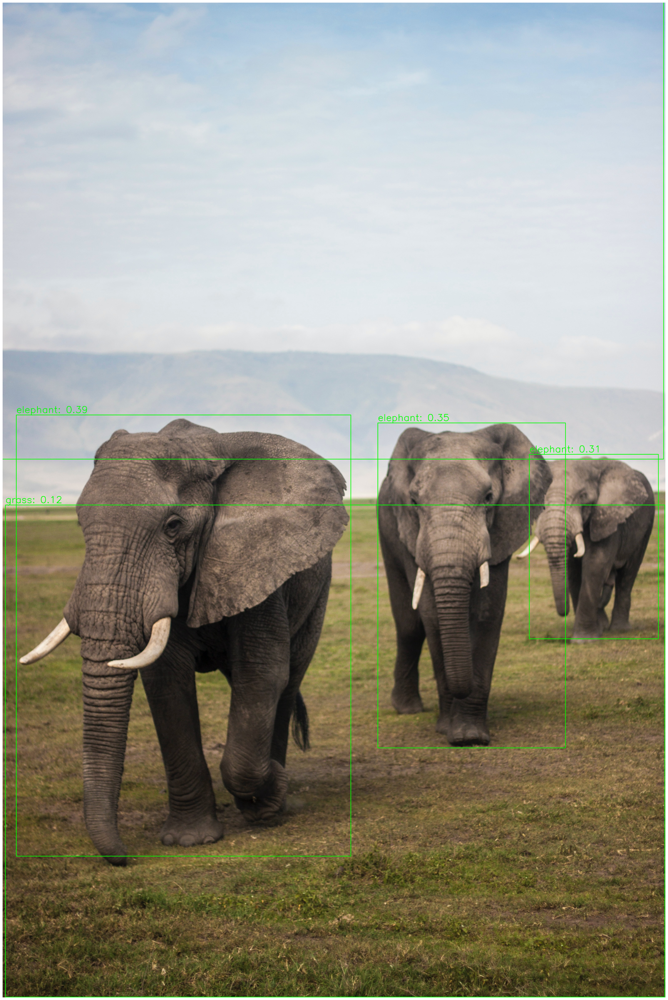

In [19]:
import cv2
from matplotlib import pyplot as plt

# Read the image
image_path = "./data/elephants.jpg"
image = cv2.imread(image_path)

# Convert the image from BGR to RGB format
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Draw the bounding box and label for each detected object
# (assuming 'detected' is a list of detections)
for detection in detected:
    box = detection['box']
    label = detection['label']
    score = detection['score']

    xmin, ymin, xmax, ymax = box['xmin'], box['ymin'], box['xmax'], box['ymax']
    cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
    cv2.putText(image, f"{label}: {score:.2f}", (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)

# Get image dimensions
height, width, _ = image.shape

# Convert image dimensions from pixels to inches for matplotlib
dpi = 96 # You can adjust this value
figsize = width / dpi, height / dpi

# Create a figure of the right size
plt.figure(figsize=figsize)

# Display the image in Jupyter Notebook
plt.imshow(image)
plt.axis('off')
plt.show()


In [26]:
from datasets import load_dataset

dataset = load_dataset("ashraq/fashion-product-images-small")
dataset


Extracting data files:   0%|          | 0/1 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/44072 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['id', 'gender', 'masterCategory', 'subCategory', 'articleType', 'baseColour', 'season', 'year', 'usage', 'productDisplayName', 'image'],
        num_rows: 44072
    })
})

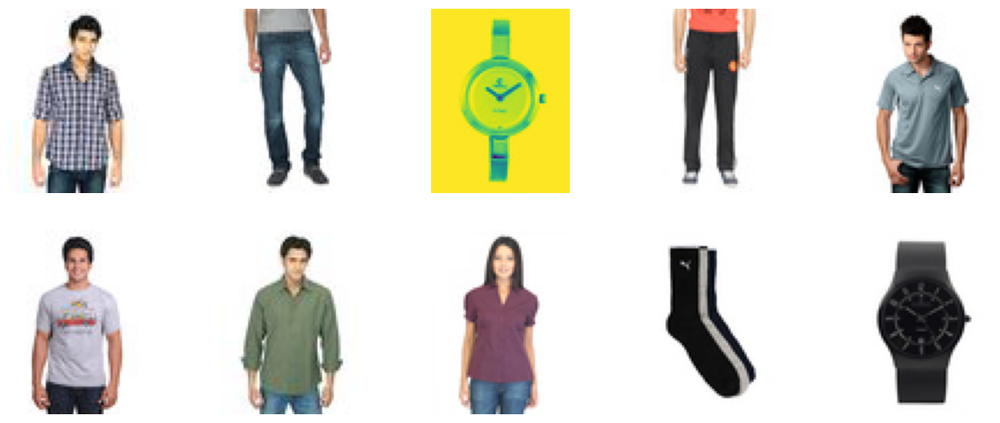

In [27]:
import matplotlib.pyplot as plt

training_split = dataset["train"]

def display_images(images):
    fig, axes = plt.subplots(2, 5, figsize=(15, 6))
    axes = axes.ravel()

    for idx, img in enumerate(images):
        axes[idx].imshow(img)
        axes[idx].axis('off')

    plt.subplots_adjust(wspace=0.2, hspace=0.2)
    plt.show()

images = [example["image"] for example in training_split.select(range(10))]
display_images(images)


In [28]:
import torch
import torchvision.transforms as transforms
from PIL import Image
from datasets import load_dataset
from transformers import CLIPProcessor, CLIPModel

device = "cuda" if torch.cuda.is_available() else "cpu"
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

def get_image_features(image):
    with torch.no_grad():
        inputs = processor(images=[image], return_tensors="pt", padding=True)
        inputs.to(device)
        features = model.get_image_features(**inputs)
    return features.cpu().numpy()

def add_image_features(example):
    example["features"] = get_image_features(example["image"])
    return example

# Apply the function to the training_split
training_split = training_split.map(add_image_features)


Map:   0%|          | 0/44072 [00:00<?, ? examples/s]

In [29]:
import numpy as np
import faiss

features = [example["features"] for example in training_split]
features_matrix = np.vstack(features)

dimension = features_matrix.shape[1]

index = faiss.IndexFlatL2(dimension)
index.add(features_matrix.astype('float32'))


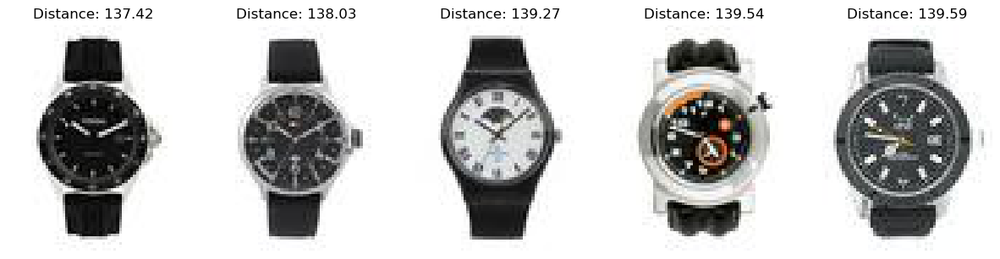

In [37]:
def get_text_features(text):
    with torch.no_grad():
        inputs = processor(text=[text], return_tensors="pt", padding=True)
        inputs.to(device)
        features = model.get_text_features(**inputs)
    return features.cpu().numpy()

def search(query_text, top_k=5):
    # Get the text feature vector for the input query
    text_features = get_text_features(query_text)

    # Perform a search using the FAISS index
    distances, indices = index.search(text_features.astype("float32"), top_k)

    # Get the corresponding images and distances
    results = [
        {"image": training_split[int(i)]["image"], "distance": distances[0][j]}
        for j, i in enumerate(indices[0])
    ]

    return results

query_text = "A black watch"
results = search(query_text)

# Display the search results
def display_search_results(results):
    fig, axes = plt.subplots(1, len(results), figsize=(15, 5))
    axes = axes.ravel()

    for idx, result in enumerate(results):
        axes[idx].imshow(result["image"])
        axes[idx].set_title(f"Distance: {result['distance']:.2f}")
        axes[idx].axis('off')

    plt.subplots_adjust(wspace=0.2, hspace=0.2)
    plt.show()

display_search_results(results)


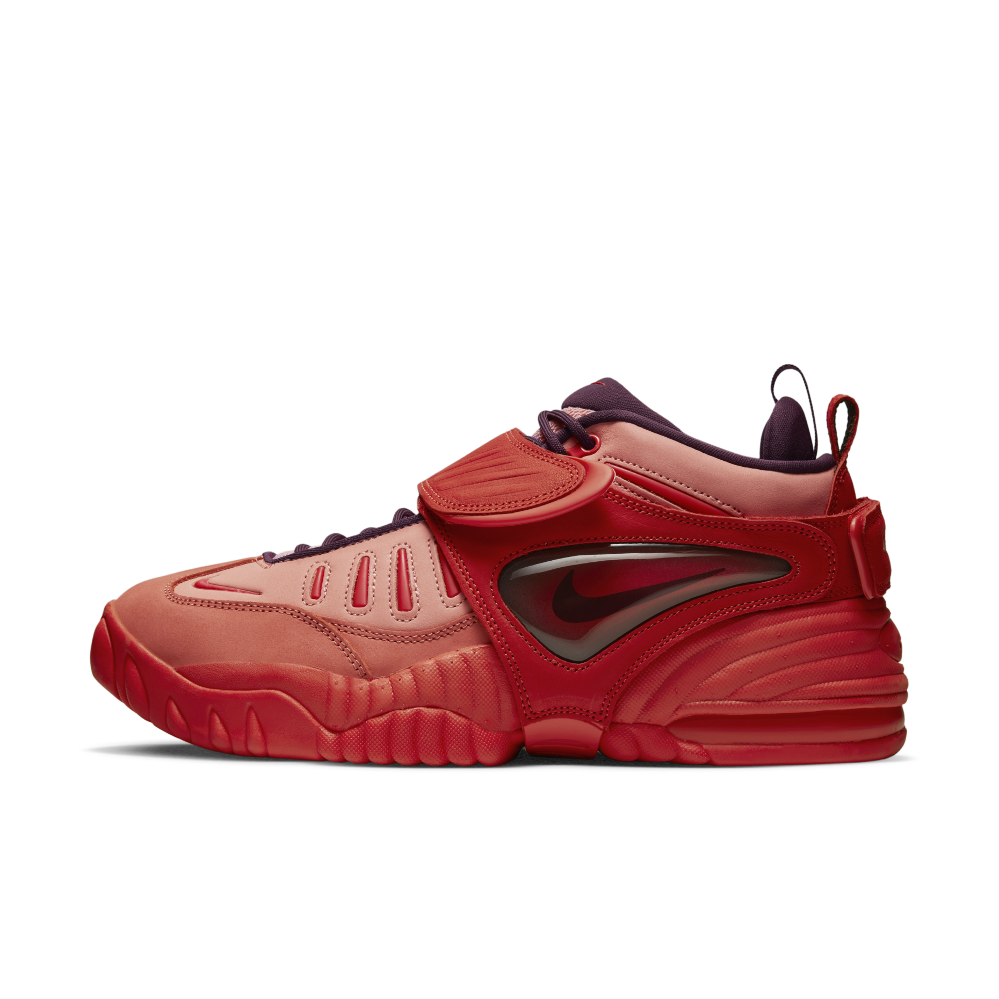

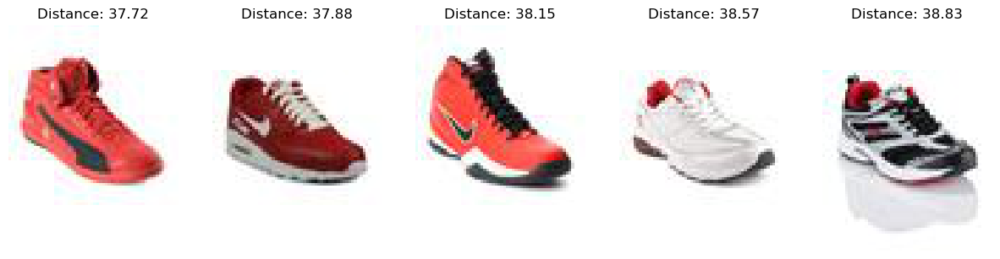

In [35]:
def get_image_features(image_path):
    # Load the image from the file
    image = Image.open(image_path).convert("RGB")

    with torch.no_grad():
        inputs = processor(images=[image], return_tensors="pt", padding=True)
        inputs.to(device)
        features = model.get_image_features(**inputs)
    return features.cpu().numpy()

def search(image_path, top_k=5):
    # Get the image feature vector for the input image
    image_features = get_image_features(image_path)

    # Perform a search using the FAISS index
    distances, indices = index.search(image_features.astype("float32"), top_k)

    # Get the corresponding images and distances
    results = [
        {"image": training_split[i.item()]["image"], "distance": distances[0][j]}
        for j, i in enumerate(indices[0])
    ]

    return results

image_path = "./data/red_shoe.png"
results = search(image_path)

display(IPyImage(filename=image_path, width=300, height=200))
display_search_results(results)
